### Trajectory Cluster Analysis

In [17]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.colors as mcolors


In [2]:
PATH = "../data/Degree_Prevalence_ICD_Clustered-1.csv"
df = pd.read_csv(PATH)
df.head()

,Sex,Age_Group,ICD_Code,ICD_Description,Degree,Prevalence,Weighted_Degree,Age_Index,Ratio,Log_ratio,W_ratio,W_Log_ratio,DTW_Cluster
0,Male,age_1,A01,Typhoid and paratyphoid fevers,0,0.00011,0.000000,1,0.000000,NaN,0.000000,NaN,NaN
1,Male,age_1,A02,Other salmonella infections,2,0.00172,6.774610,1,1162.790698,3.065502,3938.726915,3.595356,NaN
2,Male,age_1,A03,Shigellosis,0,0.00003,0.000000,1,0.000000,NaN,0.000000,NaN,NaN
3,Male,age_1,A04,Other bacterial intestinal infections,6,0.00402,14.202501,1,1492.537313,3.173925,3532.960391,3.548139,NaN
4,Male,age_1,A05,"Oth bacterial foodborne intoxications, NEC",0,0.00006,0.000000,1,0.000000,NaN,0.000000,NaN,NaN


In [3]:
df = df.dropna(subset=['DTW_Cluster'])
df.head()

,Sex,Age_Group,ICD_Code,ICD_Description,Degree,Prevalence,Weighted_Degree,Age_Index,Ratio,Log_ratio,W_ratio,W_Log_ratio,DTW_Cluster
2684,Male,age_4,A01,Typhoid and paratyphoid fevers,0,0.00007,0.0,4,0.0,NaN,0.0,NaN,0.0
2685,Male,age_4,A02,Other salmonella infections,0,0.00026,0.0,4,0.0,NaN,0.0,NaN,0.0
2687,Male,age_4,A04,Other bacterial intestinal infections,0,0.00201,0.0,4,0.0,NaN,0.0,NaN,0.0
2688,Male,age_4,A05,"Oth bacterial foodborne intoxications, NEC",0,0.00026,0.0,4,0.0,NaN,0.0,NaN,0.0
2689,Male,age_4,A06,Amebiasis,0,0.00003,0.0,4,0.0,NaN,0.0,NaN,0.0


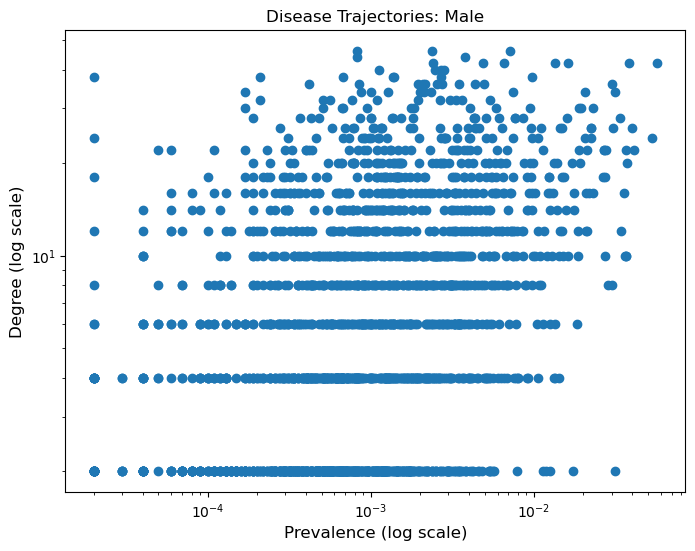

In [9]:
result_df = df[df['DTW_Cluster'] == 0.0]


plt.figure(figsize=(8, 6))

scatter = plt.scatter(result_df['Prevalence'], result_df['Degree']) # s is the marker size
plt.xlabel('Prevalence (log scale)',fontsize=12)
plt.ylabel('Degree (log scale)',fontsize=12)
plt.title('Disease Trajectories: Male')
plt.xscale('log')
plt.yscale('log')

Found 14 unique diseases for males in cluster 2.0.
Plotting trajectories for: ['E11' 'E14' 'E66' 'E78' 'E79' 'F10' 'F17' 'F32' 'I10' 'I25' 'J44' 'K21'
 'K29' 'K76']


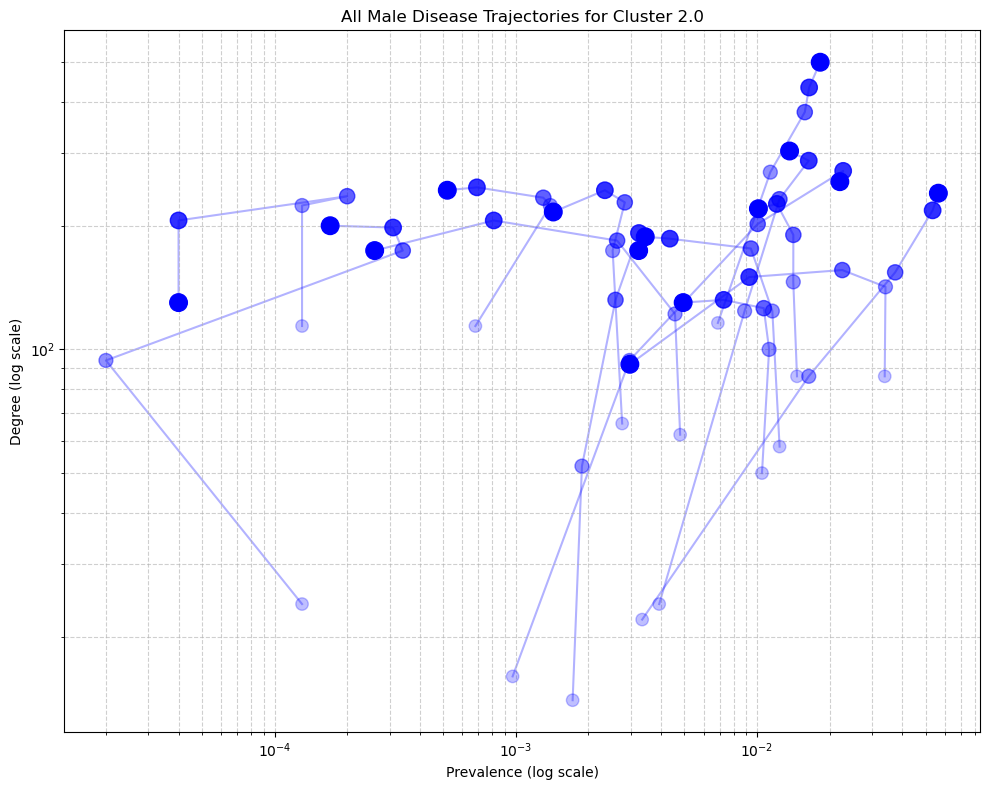

In [21]:
CLUSTER_TO_PLOT = 2.0
result_df = df[(df['DTW_Cluster'] == CLUSTER_TO_PLOT) & (df['Sex'] == 'Male')]

# Get a list of all unique diseases within the filtered data
diseases_to_plot = result_df['ICD_Code'].unique()

print(f"Found {len(diseases_to_plot)} unique diseases for males in cluster {CLUSTER_TO_PLOT}.")
print(f"Plotting trajectories for: {diseases_to_plot}")


# --- 2. Create the Plot ---
plt.figure(figsize=(10, 8))
ax = plt.gca()

# --- Define constants for unified color and marker size scaling ---
UNIFORM_COLOR = 'blue'
SIZE_SCALING_FACTOR = 20
MIN_ALPHA = 0.25 # Set a minimum alpha so that the first points are not invisible

# --- Find the range of Age_Index to normalize alpha values ---
# Handle case where there might be no data
if not result_df.empty:
    min_age = result_df['Age_Index'].min()
    max_age = result_df['Age_Index'].max()
else:
    min_age, max_age = 1, 1
    
# Get the base RGB color from the name
base_rgb_color = mcolors.to_rgb(UNIFORM_COLOR)


# --- 3. Loop Through Each Disease and Plot its Trajectory ---
for i, disease_code in enumerate(diseases_to_plot):
    trajectory_df = result_df[result_df['ICD_Code'] == disease_code].sort_values('Age_Index')
    
    # --- Calculate marker properties ---
    # 1. Size increases with Age_Index
    marker_sizes = trajectory_df['Age_Index'] * SIZE_SCALING_FACTOR
    
    # 2. Alpha (transparency) increases with Age_Index
    # Normalize age index to a 0-1 range
    if max_age > min_age:
        normalized_age = (trajectory_df['Age_Index'] - min_age) / (max_age - min_age)
    else: # Avoid division by zero if all points have the same age_index
        normalized_age = 1.0
    
    # Map normalized age to an alpha range from MIN_ALPHA to 1.0
    alphas = MIN_ALPHA + normalized_age * (1 - MIN_ALPHA)
    
    # Create an array of RGBA colors for the markers
    rgba_colors = [(*base_rgb_color, alpha) for alpha in alphas]
    
    # Check if there are at least two points to draw a line
    if len(trajectory_df) > 1:
        # Plot the connecting line with a fixed, low alpha
        ax.plot(trajectory_df['Prevalence'], trajectory_df['Degree'],
                linestyle='-', 
                color=UNIFORM_COLOR,
                alpha=0.3,
                zorder=1) # Ensure lines are drawn behind markers
        
        # Plot the markers on top with variable size and alpha
        ax.scatter(trajectory_df['Prevalence'], trajectory_df['Degree'],
                   s=marker_sizes,
                   color=rgba_colors, # Use the calculated RGBA colors
                   zorder=2) # Ensure markers are drawn on top of lines

    else: # If only one data point exists, plot it as a single marker
        ax.scatter(trajectory_df['Prevalence'], trajectory_df['Degree'],
                   s=marker_sizes,
                   color=rgba_colors)


# --- 4. Final Plot Formatting ---
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Prevalence (log scale)')
plt.ylabel('Degree (log scale)')
plt.title(f'All Male Disease Trajectories for Cluster {CLUSTER_TO_PLOT}')
plt.grid(True, which="both", ls="--", alpha=0.6)
plt.tight_layout() 
plt.show()

In [4]:
# --- 1. Filter Data for Males ---
# We are no longer filtering by a single cluster, only by sex.
male_df = df[df['Sex'] == 'Male']

# --- 2. Setup Colors for Clusters ---
# Get all unique clusters and assign a color to each.
unique_clusters = sorted(male_df['DTW_Cluster'].unique())
# Using a colormap like 'tab10' provides a good set of distinct colors.
colors = plt.cm.tab10(np.linspace(0, 1, len(unique_clusters)))
cluster_color_map = {cluster: colors[i] for i, cluster in enumerate(unique_clusters)}

# Get a list of all unique diseases to plot for males
diseases_to_plot = male_df['ICD_Code'].unique()

print(f"Found {len(diseases_to_plot)} unique diseases for males across {len(unique_clusters)} clusters.")


# --- 3. Create the Plot ---
plt.figure(figsize=(18, 12))
ax = plt.gca()

# --- 4. Loop Through Each Disease and Plot its Trajectories by Cluster ---
for disease_code in diseases_to_plot:
    # Filter for the specific disease
    disease_df = male_df[male_df['ICD_Code'] == disease_code]
    disease_description = disease_df['ICD_Description']

    # A disease can belong to multiple clusters. We plot a separate line for each.
    for cluster_num in disease_df['DTW_Cluster'].unique():
        # Filter for the specific disease AND cluster combination
        trajectory_df = disease_df[disease_df['DTW_Cluster'] == cluster_num].sort_values('Age_Index')
        
        # Get the color assigned to this cluster
        plot_color = cluster_color_map[cluster_num]
        
        # Create a detailed label for the legend
        label = f'{disease_code} ({disease_description}) - Cluster {int(cluster_num)}'

        # Check if there are at least two points to draw a line
        if len(trajectory_df) > 1:
            ax.plot(trajectory_df['Prevalence'], trajectory_df['Degree'],
                    marker='o', 
                    linestyle='-', 
                    color=plot_color,
                    label=label)
        elif len(trajectory_df) == 1: # If only one data point exists, plot it as a single marker
            ax.scatter(trajectory_df['Prevalence'], trajectory_df['Degree'],
                       color=plot_color,
                       label=label)


# --- 5. Final Plot Formatting ---
# Set logarithmic scales for both axes for better visualization
plt.xscale('log')
plt.yscale('log')

# Set labels and a descriptive title
plt.xlabel('Prevalence (log scale)')
plt.ylabel('Degree (log scale)')
plt.title('Male Disease Trajectories Colored by Cluster')

# Add a grid for better readability
plt.grid(True, which="both", ls="--", alpha=0.6)

# Place the legend outside of the plotting area to avoid overlap
# This is necessary when there are many legend entries.
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')

# Adjust layout to prevent the legend from being cut off
plt.tight_layout(rect=[0, 0, 0.85, 1]) # Adjust the rect to make space for the legend

# Display the plot
plt.show()


Found 827 unique diseases for males across 3 clusters.


/tmp/ipykernel_29515/2090740965.py:70: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout(rect=[0, 0, 0.85, 1]) # Adjust the rect to make space for the legend
